In [2]:
import pandas as pd
import numpy as np
from PIL import Image
import re
import seaborn as sns
import string
import matplotlib.pyplot as plt
import spacy
from spacy.lang.en.stop_words import STOP_WORDS
from spacy.lang.en import English
from spacy import lemmatizer
from spacy.tokenizer import Tokenizer
import nltk
from nltk.tokenize import word_tokenize
from wordcloud import WordCloud
import altair as alt
from vega_datasets import data
from plotly.offline import iplot
import plotly.graph_objs as go
import plotly.express as px
from collections import Counter

In [6]:
amadf = pd.read_csv('amazon_co-ecommerce_sample.csv')
amadf.dropna(subset=['customer_reviews'], inplace=True)

In [7]:
amadf_sorted = amadf.drop(columns = ['uniq_id', 'number_available_in_stock', 'number_of_answered_questions', 'customers_who_bought_this_item_also_bought', 'description', 'product_information', 'product_description', 'items_customers_buy_after_viewing_this_item', 'customer_questions_and_answers'])
amadf_sorted.reset_index(inplace=True)
amadf_sorted.head(75)

,index,product_name,manufacturer,price,number_of_reviews,average_review_rating,amazon_category_and_sub_category,customer_reviews,sellers
0,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,Worth Buying For The Pictures Alone (As Ever) ...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ..."
1,1,FunkyBuys® Large Christmas Holiday Express Fes...,FunkyBuys,£16.99,2,4.5 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,Four Stars // 4.0 // 18 Dec. 2015 // By\n \...,"{""seller""=>{""Seller_name_1""=>""UHD WHOLESALE"", ..."
2,2,CLASSIC TOY TRAIN SET TRACK CARRIAGES LIGHT EN...,ccf,£9.99,17,3.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,**Highly Recommended!** // 5.0 // 26 May 2015 ...,"{""seller""=>[{""Seller_name_1""=>""DEAL-BOX"", ""Sel..."
3,3,HORNBY Coach R4410A BR Hawksworth Corridor 3rd,Hornby,£39.99,1,5.0 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,I love it // 5.0 // 22 July 2013 // By\n \n...,NaN
4,4,Hornby 00 Gauge 0-4-0 Gildenlow Salt Co. Steam...,Hornby,£32.19,3,4.7 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,Birthday present // 5.0 // 14 April 2014 // By...,NaN
...,...,...,...,...,...,...,...,...,...
70,70,Hornby R1174 Breakdown Hauler Train Set,Hornby,£74.99,4,4.8 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"Excellent small starter trainset, with a prett...","{""seller""=>[{""Seller_name_1""=>""Toy Arena"", ""Se..."
71,72,[NEW] Pureoroko C-58 water steam [NEW],Train,£27.60,1,5.0 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,but now working well and a great item. // 5.0 ...,"{""seller""=>[{""Seller_name_1""=>""Sukiyaki JP"", ""..."
72,73,Train Tech SK2 Home Signal Kit with R/G LEDs,Train Tech,£8.00,1,5.0 out of 5 stars,Hobbies > Model Trains & Railway Sets > Lighti...,Five Stars // 5.0 // 25 Mar. 2015 // By\n \...,"{""seller""=>{""Seller_name_1""=>""Gaugemaster"", ""S..."
73,74,Kato 11-105 Small Type Moter Unit (for Bandai'...,Kato,£11.01,3,5.0 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,Top quality chassis // 5.0 // 27 Aug. 2013 // ...,"{""seller""=>[{""Seller_name_1""=>""Santa Trading J..."


In [8]:
amadf_sorted['sor_review'] = amadf_sorted['customer_reviews'].str.split(pat='//')
amadf_sorted.head()

,index,product_name,manufacturer,price,number_of_reviews,average_review_rating,amazon_category_and_sub_category,customer_reviews,sellers,sor_review
0,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,Worth Buying For The Pictures Alone (As Ever) ...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",[Worth Buying For The Pictures Alone (As Ever)...
1,1,FunkyBuys® Large Christmas Holiday Express Fes...,FunkyBuys,£16.99,2,4.5 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,Four Stars // 4.0 // 18 Dec. 2015 // By\n \...,"{""seller""=>{""Seller_name_1""=>""UHD WHOLESALE"", ...","[Four Stars , 4.0 , 18 Dec. 2015 , By\n ..."
2,2,CLASSIC TOY TRAIN SET TRACK CARRIAGES LIGHT EN...,ccf,£9.99,17,3.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,**Highly Recommended!** // 5.0 // 26 May 2015 ...,"{""seller""=>[{""Seller_name_1""=>""DEAL-BOX"", ""Sel...","[**Highly Recommended!** , 5.0 , 26 May 2015..."
3,3,HORNBY Coach R4410A BR Hawksworth Corridor 3rd,Hornby,£39.99,1,5.0 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,I love it // 5.0 // 22 July 2013 // By\n \n...,NaN,"[I love it , 5.0 , 22 July 2013 , By\n \..."
4,4,Hornby 00 Gauge 0-4-0 Gildenlow Salt Co. Steam...,Hornby,£32.19,3,4.7 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,Birthday present // 5.0 // 14 April 2014 // By...,NaN,"[Birthday present , 5.0 , 14 April 2014 , B..."


In [9]:
ex_rev = []
ex_rev_unl = []
pro = []
for ind,i in enumerate(amadf_sorted['sor_review']):
   ex_rev_unl.append(i.pop())
   a = i[::4]
   for j in a:
     if 'if(ue) {' in j.strip() or 'ecx.images' in j.strip() or re.findall(r'^([A-Z][a-z])\n', j.strip()) != [] or j.strip() == '':
       continue
     pro.append(amadf_sorted['product_name'][ind])
     ex_rev.append(j)
len(ex_rev)

29496

In [10]:
rat = []
for i,j in enumerate(amadf_sorted['sor_review']):
  for k,l in enumerate(j):
    if re.findall(r'\d\.\d', l) != []:
      rat.extend(re.findall(r'\d\.\d', l))

In [11]:
rat = list(map(float, rat))
rat
del rat[-451:-1]
print(len(rat))

29496


###***Removing Punctuations, Stop Words and Emojis***

In [12]:
ex_rev_copy = ex_rev.copy()

In [13]:

punctuations = string.punctuation
 
stop_words = spacy.lang.en.stop_words.STOP_WORDS

def decontracted(phrase): 
  phrase = phrase.lower()
  phrase = re.sub(r"won\'t", "will not", phrase) 
  phrase = re.sub(r"can\'t", "can not", phrase) 
  phrase = re.sub(r"n\'t", " not", phrase) 
  phrase = re.sub(r"\'re", " are", phrase) 
  phrase = re.sub(r"\'s", " is", phrase) 
  phrase = re.sub(r"\'d", " would", phrase) 
  phrase = re.sub(r"\'ll", " will", phrase) 
  phrase = re.sub(r"\'t", " not", phrase) 
  phrase = re.sub(r"\'ve", " have", phrase) 
  phrase = re.sub(r"\'m", " am", phrase) 
  return phrase

for i,text in enumerate(ex_rev_copy):
  ex_rev_copy[i] = decontracted(text)

In [14]:
def punc_rem(sentence):
  
  
  sentence = sentence.translate(str.maketrans('', '', punctuations)) # Removing Punctuations
  emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F" 
                           u"\U0001F300-\U0001F5FF" 
                           u"\U0001F680-\U0001F6FF" 
                           u"\U0001F1E0-\U0001F1FF"  
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
  return emoji_pattern.sub(r'', sentence) # Emoji removal

for i,text in enumerate(ex_rev_copy):
  ex_rev_copy[i] = punc_rem(text)

In [ ]:
def stpw_rem(sentence):
  tok_word = word_tokenize(sentence,"english")
  b=" ".join(word for word in tok_word if word not in stop_words)  # Removing stopwords
  return b

for i,text in enumerate(ex_rev_copy):
  ex_rev_copy[i] = stpw_rem(text)

###***Lemmatization***

In [16]:
nlp = spacy.load('en')
def lemma_id(sentence):
  doc = nlp(sentence)
  lem = " ".join(token.lemma_ for token in doc)

  return lem 

for i,text in enumerate(ex_rev_copy):
  ex_rev_copy[i] = lemma_id(text)

In [17]:
rev_df = pd.DataFrame({'Review':ex_rev_copy, 'Rating': rat, 'product_name':pro})
rev_df

,Review,Rating,product_name
0,worth buying picture,4.0,Hornby 2014 Catalogue
1,magic grow boy buy give new hornby catalogue y...,5.0,Hornby 2014 Catalogue
2,amazing detail credit photographer book worthy...,5.0,Hornby 2014 Catalogue
3,purchase behalf dad asking look 00 gauge engin...,5.0,Hornby 2014 Catalogue
4,need offer hornby way train mind include rrp c...,5.0,Hornby 2014 Catalogue
...,...,...,...
29491,1st class kit mark bandai good painting do not...,5.0,Star Wars 1/72 Y-Wing Starfighter
29492,fantastic kit fiddly tiny part replace broken ...,5.0,Star Wars 1/72 Y-Wing Starfighter
29493,ok read like do not will not help say assembly...,5.0,Star Wars 1/72 Y-Wing Starfighter
29494,buy model 15th december know come japan long l...,4.0,Star Wars 1/72 Y-Wing Starfighter


###***Removing HTML***

In [18]:
for k,i in enumerate(rev_df['Review']):
  i = re.sub(r'(www.\S+|http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+)',"" , i)
  rev_df['Review'][k] = i.strip()
rev_df.head()

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Review,Rating,product_name
0,worth buying picture,4.0,Hornby 2014 Catalogue
1,magic grow boy buy give new hornby catalogue y...,5.0,Hornby 2014 Catalogue
2,amazing detail credit photographer book worthy...,5.0,Hornby 2014 Catalogue
3,purchase behalf dad asking look 00 gauge engin...,5.0,Hornby 2014 Catalogue
4,need offer hornby way train mind include rrp c...,5.0,Hornby 2014 Catalogue


In [23]:
new = pd.merge(amadf_sorted, rev_df)

In [24]:
pd.set_option('display.max_rows', new.shape[0]+1)
new = new.drop(columns=['sor_review', 'customer_reviews'])

In [25]:
new.shape

(29838, 10)

In [26]:
new

,index,product_name,manufacturer,price,number_of_reviews,average_review_rating,amazon_category_and_sub_category,sellers,Review,Rating
0,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",worth buying picture,4.0
1,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",magic grow boy buy give new hornby catalogue y...,5.0
2,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",amazing detail credit photographer book worthy...,5.0
3,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",purchase behalf dad asking look 00 gauge engin...,5.0
4,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",need offer hornby way train mind include rrp c...,5.0
5,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",collect glossy picture great nice catalog coll...,5.0
6,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",great book extremely useful insight future chr...,5.0
7,0,Hornby 2014 Catalogue,Hornby,£3.42,15,4.9 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>[{""Seller_name_1""=>""Amazon.co.uk"", ...",useful info someonelike start hobby year hornb...,5.0
8,1,FunkyBuys® Large Christmas Holiday Express Fes...,FunkyBuys,£16.99,2,4.5 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>{""Seller_name_1""=>""UHD WHOLESALE"", ...",star,4.0
9,1,FunkyBuys® Large Christmas Holiday Express Fes...,FunkyBuys,£16.99,2,4.5 out of 5 stars,Hobbies > Model Trains & Railway Sets > Rail V...,"{""seller""=>{""Seller_name_1""=>""UHD WHOLESALE"", ...",happy communication funkybuys stars,5.0


###***Visualization***
Word Cloud

In [27]:
wc_data=' '.join(i for i in ex_rev_copy)

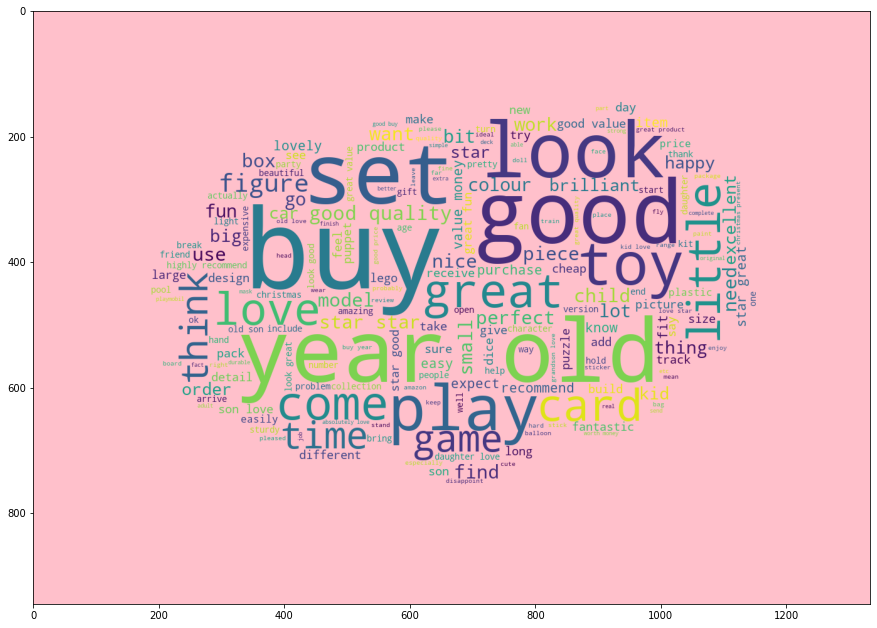

In [29]:
mask = np.array(Image.open("cloud.png"))
wc = WordCloud(mask = mask, background_color='pink').generate(wc_data)
plt.figure(figsize=[15,15])
plt.imshow(wc)

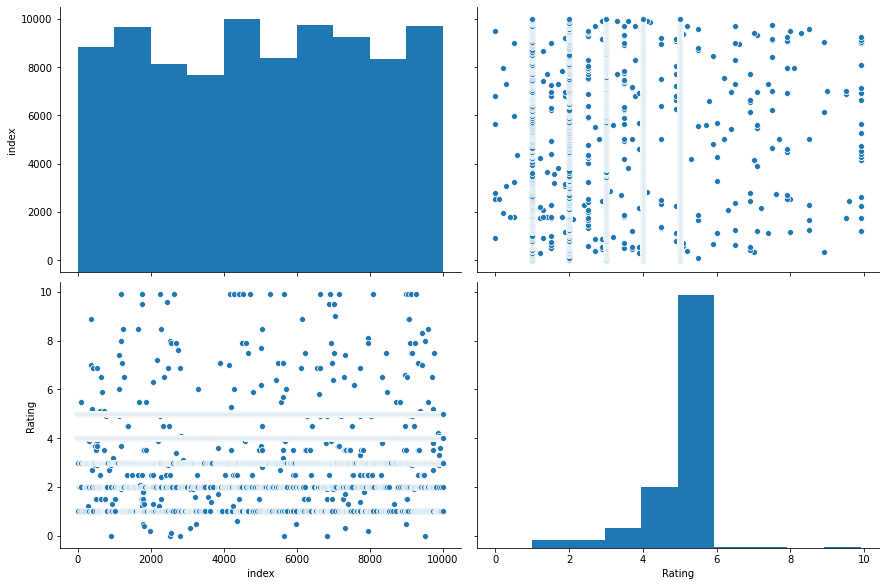

In [ ]:
sns.pairplot(new, height=4, aspect=1.5)

In [30]:
a = amadf_sorted['manufacturer'][:100]
b = amadf_sorted['price'][:100]
c = amadf_sorted['product_name'][:100]
d = amadf_sorted['amazon_category_and_sub_category'][:100]
df = pd.DataFrame(a)
df['price'] = b
df['prod'] = c
df['cat'] = d
df =df.dropna(subset=['price'])
df['price'] =df['price'].str.strip('£')
df['price'] = df['price'].astype('float')

In [31]:
r= new.groupby(['manufacturer', 'product_name', 'amazon_category_and_sub_category','price'], as_index=False)['Rating'].aggregate(np.mean)

r['price'] =r['price'].str.replace('£', '')
r['price'] = r['price'].str.replace(',','')
r['price'] = r['price'].str.replace(' - ','')
r['price'] = r.apply(lambda x : x['price'][:5], axis=1)
r['price'] = r['price'].astype('float')
r

,manufacturer,product_name,amazon_category_and_sub_category,price,Rating
0,101,Cashflow 101,Games > Educational Games,71.990,4.400000
1,16th Birthday 16th Foil Banner - 9ft,16th Birthday 16th Foil Banner - 9ft,"Party Supplies > Banners, Stickers & Confetti ...",2.130,4.000000
2,1st birthday,1St Birthday Boy Pennant Party Banner,"Party Supplies > Banners, Stickers & Confetti ...",4.460,4.500000
3,1st birthday,My First Birthday Boys Foil Balloon,Party Supplies > Decorations > Balloons,1.730,5.000000
4,2-in-1 Chess & Draughts,2-in-1 Chess & Draughts Home Set With Glass Bo...,Games > Chess,6.990,5.000000
5,24 Game,24 Game Double Digits - 48 Card Pack,Games > Educational Games,17.140,5.000000
6,4 Pocket Pro Binder Black,4-Pocket Pro Binder (Black),Hobbies > Trading Cards & Accessories > Storag...,7.990,4.750000
7,"45"" Sunset Glow Pool",John Adams Leisure 45-inch Sunset Glow Pool,Sports Toys & Outdoor > Beach Toys > Paddling ...,10.640,4.166667
8,4M,4M Dinosaur Mould and Paint,Figures & Playsets > Dinosaurs,12.660,4.500000
9,4M,4M Lemon Clock,Baby & Toddler Toys > Teaching Clocks,3.990,4.714286


Text(0.5, 0, 'Manufacturer')

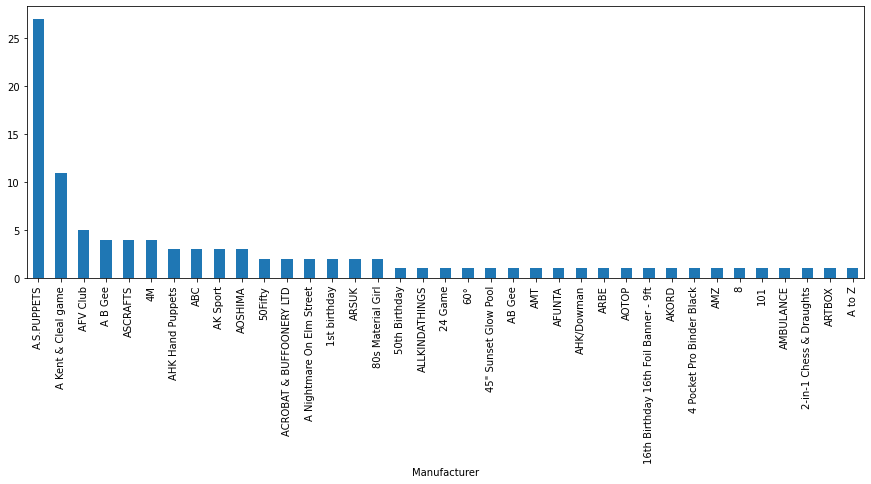

In [ ]:
# df.plot.bar(x=df['manufacturer'].value_counts(),y=df['price'],rot=0, subplots=True, figsize=[20,10])
r['manufacturer'][:100].value_counts().plot.bar(figsize=[15,5]).set_xlabel('Manufacturer')

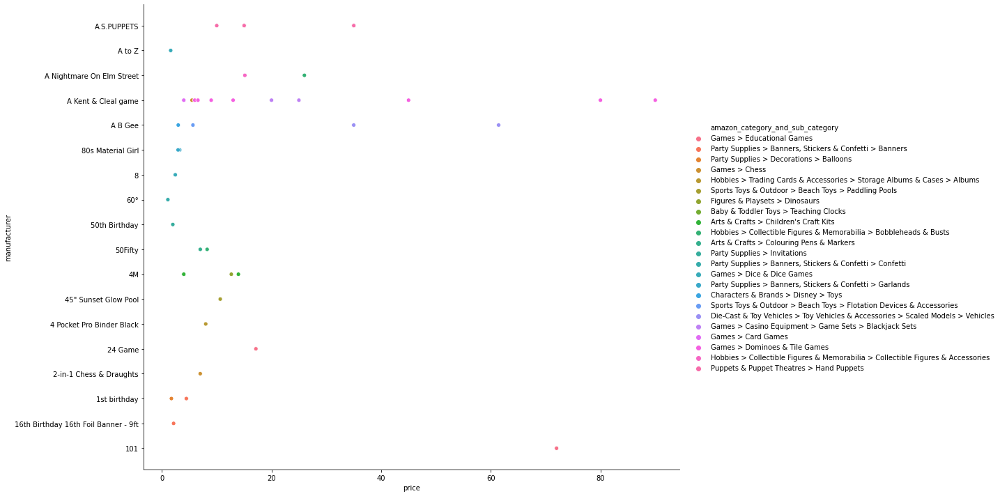

In [35]:
sns.relplot(data=r[:50], x='price', y='manufacturer', hue='amazon_category_and_sub_category',height=10, aspect=1.5)

In [33]:
alt.Chart(new[:100]).mark_point(filled=True).encode(
    alt.X('product_name'),
    alt.Y('manufacturer'),
    alt.Size('manufacturer'),
    alt.Color('manufacturer'),
    
)

alt.Chart(...)

In [36]:
alt.Chart(r[:100]).mark_point().encode(
    x='manufacturer',
    y='Rating',
).interactive()

alt.Chart(...)

In [ ]:
f = go.FigureWidget([go.Scatter(x=r['price'][:500], y=r['Rating'][:500], mode='markers')])
f.show()

####***Visualiaing top 100 words used the most***####

In [ ]:
from nltk.probability import FreqDist
tokens = word_tokenize(wc_data)
fdist=FreqDist()
for words in tokens:
  fdist[words.lower()]+=1

In [ ]:
wd_dict=dict(fdist.most_common(100))
val=wd_dict.values()
key=wd_dict.keys()
wd_df = pd.DataFrame(key,columns=['key'])
wd_df['val'] = val

In [ ]:
f = go.FigureWidget([go.Scatter(y=wd_df['val'], x=wd_df['key'], mode='markers')])
f.show()

####***Density graph as per manufacturer and category based on Rating***####

In [34]:
fig = px.density_contour(new[:100], x="manufacturer", y="amazon_category_and_sub_category", facet_col="Rating")
fig.update_traces(contours_coloring="fill", contours_showlabels = True)
fig.show()

####***Visualizing positive and negative words used in Top most up-rated and Top most down-rated Review***####

In [ ]:
pos_rev = ' '.join(i for i in new.loc[new['Rating'] > 3]['Review'])
pos_rev = word_tokenize(pos_rev)
len(pos_rev)

428235

In [ ]:
neg_rev = ' '.join(i for i in new.loc[new['Rating'] <= 3]['Review'])
neg_rev = word_tokenize(neg_rev)
len(neg_rev)

50364

In [ ]:
pos_rev_pos_wds = []
with open('/content/drive/My Drive/Group2 - Parsing product and user review data/positive-negative word list/positive-words.txt', 'r') as f:
  words = f.readlines()
  for i in pos_rev:
    if i+'\n' in words:
      pos_rev_pos_wds.append(i)

pos_rev_pos_wds = dict(Counter(pos_rev_pos_wds))
pos_rev_pos_wds = pd.DataFrame(pos_rev_pos_wds, index=[0])
pos_rev_pos_wds = pos_rev_pos_wds.T.reset_index().reindex(columns=['index', 0])
pos_rev_pos_wds = pos_rev_pos_wds.rename(columns={'index': 'Words', 0:'Count'})

In [ ]:
pos_rev_neg_wds = []
with open('/content/drive/My Drive/Group2 - Parsing product and user review data/positive-negative word list/negative-words.txt','r+',encoding="ISO-8859-1") as f:
  words = f.readlines()
  for i in pos_rev:
    if i+'\n' in words:
      pos_rev_neg_wds.append(i)

pos_rev_neg_wds = dict(Counter(pos_rev_neg_wds))
pos_rev_neg_wds = pd.DataFrame(pos_rev_neg_wds, index=[0])
pos_rev_neg_wds = pos_rev_neg_wds.T.reset_index().reindex(columns=['index', 0])
pos_rev_neg_wds = pos_rev_neg_wds.rename(columns={'index': 'Words', 0:'Count'})

In [ ]:
neg_rev_pos_wds = []
with open('/content/drive/My Drive/Group2 - Parsing product and user review data/positive-negative word list/positive-words.txt', 'r') as f:
  words = f.readlines()
  for i in neg_rev:
    if i+'\n' in words:
      neg_rev_pos_wds.append(i)

neg_rev_pos_wds = dict(Counter(neg_rev_pos_wds))
neg_rev_pos_wds = pd.DataFrame(neg_rev_pos_wds, index=[0])
neg_rev_pos_wds = neg_rev_pos_wds.T.reset_index().reindex(columns=['index', 0])
neg_rev_pos_wds = neg_rev_pos_wds.rename(columns={'index': 'Words', 0:'Count'})

In [ ]:
neg_rev_neg_wds = []
with open('/content/drive/My Drive/Group2 - Parsing product and user review data/positive-negative word list/negative-words.txt','r+',encoding="ISO-8859-1") as f:
  words = f.readlines()
  for i in neg_rev:
    if i+'\n' in words:
      neg_rev_neg_wds.append(i)

neg_rev_neg_wds = dict(Counter(neg_rev_neg_wds))
neg_rev_neg_wds = pd.DataFrame(neg_rev_neg_wds, index=[0])
neg_rev_neg_wds = neg_rev_neg_wds.T.reset_index().reindex(columns=['index', 0])
neg_rev_neg_wds = neg_rev_neg_wds.rename(columns={'index': 'Words', 0:'Count'})

In [ ]:
f = go.FigureWidget([go.Bar(x=['neg','pos'], y=[pos_rev_neg_wds['Count'].sum(),pos_rev_pos_wds['Count'].sum()])])
f.show()

In [ ]:
f = go.FigureWidget([go.Bar(x=['neg','pos'], y=[neg_rev_neg_wds['Count'].sum(),neg_rev_pos_wds['Count'].sum()])])
f.show()